## Vehicle Detection Project

#### The goals / steps of this project are the following:

* Perform a Histogram of Oriented Gradients (HOG) feature extraction on a labeled training set of images and train a classifier Linear SVM classifier
* Apply a color transform and append binned color features, as well as histograms of color, to your HOG feature vector.
* Experiment training your classifier on HOG/Color features only and then on the combination of two.
* Note: for those first two steps don't forget to normalize your features and randomize a selection for training and testing.
* Using a decision Tree classifier, explore the feature importances and consider pruning or adding new features.
* Implement a sliding-window technique and use your trained classifier to search for vehicles in images.
* Estimate a bounding box for vihecles detected.
* Run your pipeline on a video stream (start with the test_video.mp4 and later implement on full project_video.mp4) and create a heat map of recurring detections frame by frame to reject outliers and follow detected vehicles.
* Estimate distance and trajectory of detected vehicles in upcoming frames.

First I import all the required modules and packages throughout the code. 

In [1]:
# Import all the required modules and packages
import lesson_functions
import os
import time
import glob
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
import pickle
import cv2
from scipy.ndimage.measurements import label
from skimage import color, exposure
from sklearn.svm import LinearSVC
from sklearn.preprocessing import StandardScaler
from skimage.feature import hog
from lesson_functions import *
from sklearn.model_selection import train_test_split
from mpl_toolkits.mplot3d import Axes3D
from scipy.ndimage.measurements import label
from moviepy.editor import VideoFileClip
from IPython.display import HTML
import collections
from sklearn.model_selection import GridSearchCV

%matplotlib inline

I have also stored all the lesson funstions in "lesson_functions.py" and you can find all of the method definitions in that file. Most of them are directly provided in lessons and exercises. Some of these methods are modified to work with my code.

## Training Set Modifications
In order to get better results and less false poritives, I decided to modify my trainig set a little bit. Both of the following approches have increased my classifier accuracy by %0.5

### Negetive Maning:
Althought I have used decision_function, as well heatmap integration over multiple frames and thresholdings, still I was getting too many false positives. To over come this problem, I tried negetive mining approach suggested by my reviewer, which according to my reviewer is cutting out non-car images from the project video,and adding them to the training set and retrain the classifier.
To do so, I need to capture all the video frames to be able to identify the none-car frames later. I have comment it out cause I only needed to do it once, and remove the rest of frames to keep my submition light size-wise.

In [ ]:
video_in = 'project_video.mp4'
vidcap = cv2.VideoCapture(video_in)

success,image = vidcap.read()
count = 0; 
while success:
    success,image = vidcap.read()# image is an array of array of [R,G,B] values
    cv2.imwrite("output_images/frame%d.png" % count, image)     # save frame as JPEG file
    if cv2.waitKey(10) == 27:                     # exit if Escape is hit
        break
    count += 1
print("frames saved.")

I select few of the frames that confuses my trainig sets and around them and them to my 'extra' training set in 'non-vehicle' directory. I also need to convert them to .png format images. Here are a few sample of them:

In [ ]:
video_frames = glob.glob('output_images/*.png')
# print(len(video_frames))
i = 0
for img in video_frames:
    image = cv2.imread(img)
#     cv2.imwrite("output_images/retyped%d.png" % i, image) 
    image = cv2.resize(image, (64,64))
#     image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    cv2.imwrite("output_images/resizedframe%d.png" % i, image) 
    i += 1
print("images resized.")

Negetive Mining has improved my classifier accuracy from 0.9907 to 0.9941! So It should be doing better with false negetives. Just to keep the write up short and easy to follow, I remove the cells that I have done the importing data again as well as training my classifier again and just keep the final results.

### More White Cars 
My classifer had some issues with detecting white cars. Specially I would use thresholds to eliminate false positives, it would filter out white cars as well. So I decided to add more white car images to my training set. To do so, I used Udacity 's "Annotated Driving Dataset" and cropped some of the white cars from the data set and rewrote them as png images. I also resized them to 64by64 images:

In [ ]:
white_cars = glob.glob('WhiteCar/*.jpg')
# print(len(video_frames))
i = 0
for img in white_cars:
    image = cv2.imread(img)
    cv2.imwrite("WhiteCar/retyped%d.png" % i, image)
    image = cv2.resize(image, (64,64))
#    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    cv2.imwrite("WhiteCar/resizedframe%d.png" % i, image)
    i += 1
print("images resized.")

## Importing Data
Here I read all the non-vehicle and vehicle images from different directories and store them in two different text files, 'cars.txt' and 'notcars.txt'. 

In [2]:
# First We need to read in the images. 
# The data base is divided to notcar and car vehicles provided with different sources.

notcar_dir = 'non-vehicles/'
car_dir = 'vehicles/'
notcar_subdir = os.listdir(notcar_dir)
car_subdir = os.listdir(car_dir)

cars = []
not_cars = []

print("dires", notcar_dir, notcar_subdir)
print("dires", car_dir, car_subdir)

# for sub_dirs in notcar_subdir:
#     image = glob.glob(notcar_dir+sub_dirs+'/*')
#     not_cars.extend(image)
    
image = glob.glob(notcar_dir+notcar_subdir[1]+'/*')
not_cars.extend(image)
image = glob.glob(notcar_dir+notcar_subdir[2]+'/*')
not_cars.extend(image)
image = glob.glob(notcar_dir+notcar_subdir[3]+'/*')
not_cars.extend(image)
image = glob.glob(notcar_dir+notcar_subdir[4]+'/*')
not_cars.extend(image)
    
    
# for sub_dirs in car_subdir:
#     image = glob.glob(car_dir+sub_dirs+'/*')
#     cars.extend(image)

image = glob.glob(car_dir+car_subdir[1]+'/*')
cars.extend(image)
image = glob.glob(car_dir+car_subdir[2]+'/*')
cars.extend(image)
image = glob.glob(car_dir+car_subdir[3]+'/*')
cars.extend(image)
image = glob.glob(car_dir+car_subdir[4]+'/*')
cars.extend(image)
image = glob.glob(car_dir+car_subdir[5]+'/*')
cars.extend(image)
image = glob.glob(car_dir+car_subdir[6]+'/*')
cars.extend(image)

print("Number of Vehicles and non-vehicles: ", len(cars),len(not_cars))

with open("cars.txt", 'w') as f:
    for car in cars:
        f.write(car+'\n')
        
with open("notcars.txt", 'w') as f:
    for notcars in not_cars:
        f.write(notcars+'\n')

        
cars = np.array(cars)
not_cars = np.array(not_cars)

dires non-vehicles/ ['.DS_Store', 'Extras', 'GTI', 'Negitive_Mining_Data', 'Negitive_Mining_Data2']
dires vehicles/ ['.DS_Store', 'GTI_Far', 'GTI_Left', 'GTI_MiddleClose', 'GTI_Right', 'KITTI_extracted', 'White_Cars_Right']
Number of Vehicles and non-vehicles:  8803 9002


### Histogram of Oriented Gradients (HOG)
In the next block of code, I explored different color spaces and hog parameters to get a feel for the effect of each parameter on extracted features. 

In [3]:
sample_car = cars[20]
sample_notcar = not_cars[20]

sample_car_image = mpimg.imread(sample_car)            
sample_notcar_image = mpimg.imread(sample_notcar)

# Reduce the sample size because
# The quiz evaluator times out after 13s of CPU time
# sample_size = 500
# cars_sample = cars[0:sample_size]
# notcars_sample = not_cars[0:sample_size]

### TODO: Tweak these parameters and see how the results change.
color_space = 'YCrCb' # Can be RGB, HSV, LUV, HLS, YUV, YCrCb
orient = 9  # HOG orientations- it was 9
pix_per_cell = 8 # HOG pixels per cell
cell_per_block = 2 # HOG cells per block
hog_channel = 0 # Can be 0, 1, 2, or "ALL"
spatial_size = (32, 32) # Spatial binning dimensions
hist_bins = 64    # Number of histogram bins
spatial_feat = True # Spatial features on or off
hist_feat = True # Histogram features on or off
hog_feat = True # HOG features on or off
y_start_stop = [None, None] # Min and max in y to search in slide_window()

car_features, car_hog_image = single_img_features(sample_car_image, color_space=color_space,
                                spatial_size=spatial_size, hist_bins=hist_bins,
                                orient=orient, pix_per_cell=pix_per_cell,
                                cell_per_block=cell_per_block,
                                hog_channel=hog_channel, spatial_feat=spatial_feat,
                                hist_feat=hist_feat, hog_feat=hog_feat, vis = True)

notcar_features, notcar_hog_image = single_img_features(sample_notcar_image, color_space=color_space,
                                   spatial_size=spatial_size, hist_bins=hist_bins,
                                   orient=orient, pix_per_cell=pix_per_cell,
                                   cell_per_block=cell_per_block,
                                   hog_channel=hog_channel, spatial_feat=spatial_feat,
                                   hist_feat=hist_feat, hog_feat=hog_feat, vis=True)

I also selected two sample images from notcars and cars images and visualized how does a hog image looks like.

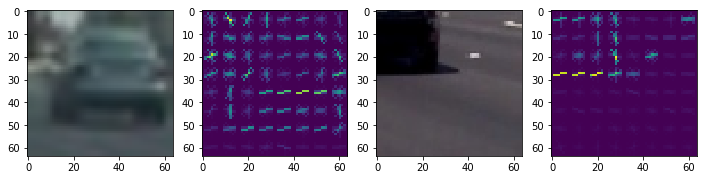

In [4]:
%matplotlib inline

images = [sample_car_image, car_hog_image, sample_notcar_image, notcar_hog_image]

fig = plt.figure(figsize=(12,3))
for i, img in enumerate(images):
    plt.subplot(1,4, i+1)
    plt.imshow(img)       
plt.show()

### Final selected parameters
After trying different color spaces and hog parameters, on different classifiers, I decided to use Linear SVC with the following parameters, since it gave me the highest accuracy of 0.9938 among other combinations.

Here are some of the try and error results I took out of experiencing different combinations:
* Seems that color spaces YUV and YCrCb are the best options to work with, however YUV had some troubles finding black cars and YCrCb had the same issue with white cars. Between these two I chose YCrCb cause the accuracy of my SVM training was higher in this color space.
* Also it seems keeping 9 to 11 factor for orientation is more than enough. Too big a orientaion factor causes too many false positives. I decided to stick with 9.
* Using all hog channels is for sure better than single channel, working with YUV and YCrCb color channels. 
* As someone suggested in the forum, I reduced the size of training data to 6K, and that increased my accuracy by 0.001(0.9958). However in my final video result I felt using the whole training set has better results.
* With the help of my first reviewer, I learned about C parameter in training my classifier. According to the link that my reviwer provided for me "The C parameter tells the SVM optimization how much you want to avoid misclassifying each training example. For large values of C, the optimization will choose a smaller-margin hyperplane if that hyperplane does a better job of getting all the training points classified correctly." and I also leanred about Hyper-parameters are parameters that are not directly learnt within estimators. Then I learned about GridSearchCV, and decided to use it for better results.

In [25]:
# Reduce the sample size because
# The quiz evaluator times out after 13s of CPU time
# sample_size = 1000
# cars_sample = cars[0:sample_size]
# notcars_sample = not_cars[0:sample_size]

# sample_cars = cars[0:6000]
# notcars_sample = not_cars[0:6000]

sample_cars = cars
notcars_sample = not_cars

### TODO: Tweak these parameters and see how the results change.
color_space = 'YCrCb' # Can be RGB, HSV, LUV, HLS, YUV, YCrCb
orient = 9  # HOG orientations- it was 9
pix_per_cell = 8 # HOG pixels per cell
cell_per_block = 2 # HOG cells per block
hog_channel = 'ALL' # Can be 0, 1, 2, or "ALL"
spatial_size = (32, 32) # Spatial binning dimensions
hist_bins = 32    # Number of histogram bins
spatial_feat = True # Spatial features on or off
hist_feat = True # Histogram features on or off
hog_feat = True # HOG features on or off



car_features = extract_features(sample_cars, color_space=color_space,
                                spatial_size=spatial_size, hist_bins=hist_bins,
                                orient=orient, pix_per_cell=pix_per_cell,
                                cell_per_block=cell_per_block,
                                hog_channel=hog_channel, spatial_feat=spatial_feat,
                                hist_feat=hist_feat, hog_feat=hog_feat )

notcar_features = extract_features(notcars_sample, color_space=color_space,
                                   spatial_size=spatial_size, hist_bins=hist_bins,
                                   orient=orient, pix_per_cell=pix_per_cell,
                                   cell_per_block=cell_per_block,
                                   hog_channel=hog_channel, spatial_feat=spatial_feat,
                                   hist_feat=hist_feat, hog_feat=hog_feat)

print("notcar_features and car_features length ", len(notcar_features), len(car_features))

#notcar_features = np.array(notcar_features)
#car_features = np.array(car_features)
#print("notcar_features and car_features shape: ", notcar_features.shape, car_features.shape)

X = np.vstack((car_features, notcar_features)).astype(np.float64)
# Fit a per-column scaler
X_scaler = StandardScaler().fit(X)
# Apply the scaler to X
scaled_X = X_scaler.transform(X)

# Define the labels vector
y = np.hstack((np.ones(len(car_features)), np.zeros(len(notcar_features))))


# Split up data into randomized training and test sets
rand_state = np.random.randint(0, 100)
X_train, X_test, y_train, y_test = train_test_split(scaled_X, y, test_size=0.2, random_state=rand_state)

print('Using:',orient,'orientations',pix_per_cell,'pixels per cell and', cell_per_block,'cells per block')
print('Feature vector length:', len(X_train[0]))
# Use a linear SVC
# svc = LinearSVC()
# Set the parameters by cross-validation
svc = GridSearchCV(LinearSVC(), param_grid={'C':np.logspace(-3,-2,5)})
# svc = GridSearchCV(LinearSVC(), param_grid=[{'C': [0.001, 0.01, 1, 10, 100, 1000]}])
# Check the training time for the SVC
print("Training ...")
t=time.time()
svc.fit(X_train, y_train)
t2 = time.time()

# print("decision function: ",svc.decision_function(X_train))
# print("predict: ",svc.predict(X_train))

print(round(t2-t, 2), 'Seconds to train SVC...')
print("GridSearchCV results : ", svc.best_estimator_)
# Check the score of the SVC
print('Test Accuracy of SVC = ', round(svc.score(X_test, y_test), 4))
# Check the prediction time for a single sample
t=time.time()




notcar_features and car_features length  9002 8803
Using: 9 orientations 8 pixels per cell and 2 cells per block
Feature vector length: 8460
Training ...
148.65 Seconds to train SVC...
GridSearchCV results :  LinearSVC(C=0.0017782794100389228, class_weight=None, dual=True,
     fit_intercept=True, intercept_scaling=1, loss='squared_hinge',
     max_iter=1000, multi_class='ovr', penalty='l2', random_state=None,
     tol=0.0001, verbose=0)
Test Accuracy of SVC =  0.9905


## Sliding Window Search
I read some where in the forum that if I pick more overlaps and smaller windows sizes, cars can get detected much easier multiple time, and later these multiple detections can easily be thresholded using heatmaps. So after trying different values, I decided to go with windows size (96,96) and overlap of (0.75,0.75). 
I also leanred in lectures that limiting the search area to the bottom half of image, makes more sense as we are not looking for flying cars in the sky! 

number of windows 350
number of windows 350
number of windows 350
number of windows 350
number of windows 350
number of windows 350


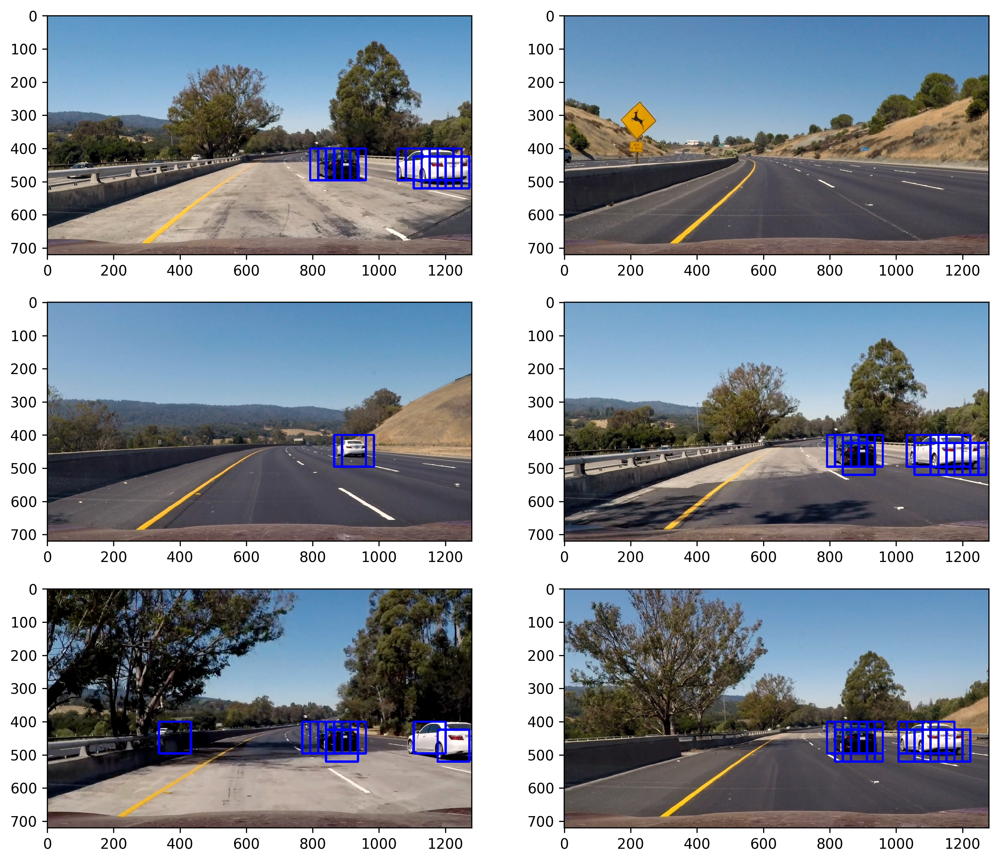

In [15]:
y_start_stop = [400, 656] # Min and max in y to search in slide_window()
images = glob.glob('test_images/*.jpg')
out_images = []
for img in images:
    image = mpimg.imread(img) # These jpg images are scaled 0 to 255 with mpimg.read
    draw_image = np.copy(image)    
#     Uncomment the following line if you extracted training
#     data from .png images (scaled 0 to 1 by mpimg) and the
#     image you are searching is a .jpg (scaled 0 to 255)

    image = image.astype(np.float32)/255

    windows = slide_window(image, x_start_stop=[None, None], y_start_stop=y_start_stop,
                       xy_window=(96,96), xy_overlap=(0.75, 0.75))   # 96 and 0.5, 0.5

    hot_windows = search_windows(image, windows, svc, X_scaler, color_space=color_space,
                             spatial_size=spatial_size, hist_bins=hist_bins,
                             orient=orient, pix_per_cell=pix_per_cell,
                             cell_per_block=cell_per_block,
                             hog_channel=hog_channel, spatial_feat=spatial_feat,
                             hist_feat=hist_feat, hog_feat=hog_feat)

    window_img = draw_boxes(draw_image, hot_windows, color=(0, 0, 255), thick=6)
    print("number of windows", len(windows))
    out_images.append(window_img)

fig = plt.figure(figsize=(12,18), dpi=300)
for i, img in enumerate(out_images):
    plt.subplot(5, 2, i+1)
    plt.imshow(img)




Now we want to take the hog features for the entire an image, or better say a part of it once, and sub-sampling that array to extract fetures for each window. To do so, as lectures suggested, we use find_cars method (see the definition in the following code block) and later we use this method in our video pipline.
We also need to get ride of multiple detections and false positives. 
In the next following block of code you will see excatly what will happen in my video pipeline:
* First we send the image to find_car which is simillar to sliding windows method but extracts the hog features for the entire image once. 
* There is a scaling factor that determines the size of the sliding windows. scaling factor of 1 for 8 pixel per cell, means that the size of windows is going to be 8 by 8 pixels. First I decided to chose 1.5 which is not too big and not too small.However there is another approach that I learned about it in the forums, which is using multiple scaling at the same time. I tried both approaches. Although detection of cars are much better using multiple scales, but false positives were happening more often using this approach as well. I played around with both approches and eventually decided to use single scale of 1.5. This scale performs better than 1.0, 1.1, 1.2, 1.3, 1.4, 2.0 and 2.5 scales that I have tried. 
* Then there will be a heatmap added to every single frame that there is a detection. Later we can put threshold on these heatmaps to get rid of false positives.
* I have used decision_function in my pipeline instead of prediction function as my reviewer suggested, which helped with getting fewer false positives.



In [16]:
def find_cars(img, ystart, ystop, scale, svc, X_scaler, orient, pix_per_cell, cell_per_block, spatial_size, hist_bins, decision_th):
    image_box = []
    draw_img = np.copy(img)
    img = img.astype(np.float32)/255 #test images and also video clips are jpg format scaled 0 to 255
    heat = np.zeros_like(img[:,:,0]).astype(np.float)
    
    img_tosearch = img[ystart:ystop,:,:] # image[y,x]
    ctrans_tosearch = convert_color(img_tosearch, conv='RGB2YCrCb')
    #     ctrans_tosearch = convert_color(img_tosearch, conv='RGB2YUV')
    if scale != 1:
        imshape = ctrans_tosearch.shape
        ctrans_tosearch = cv2.resize(ctrans_tosearch, (np.int(imshape[1]/scale), np.int(imshape[0]/scale)))
    
    ch1 = ctrans_tosearch[:,:,0]
    ch2 = ctrans_tosearch[:,:,1]
    ch3 = ctrans_tosearch[:,:,2]

    # Define blocks and steps as above
    # number of hug cells
    nxblocks = (ch1.shape[1] // pix_per_cell) - 1 #- 1#cell_per_block + 1
    nyblocks = (ch1.shape[0] // pix_per_cell) - 1#- 1# cell_per_block + 1
    # number of features per block
    nfeat_per_block = orient*cell_per_block**2
    
    # 64 was the orginal sampling rate, with 8 cells and 8 pix per cell
    window = 64
    nblocks_per_window = (window // pix_per_cell) - 1 # - 1 #cell_per_block + 1
    cells_per_step = 1  # Instead of overlap, define how many cells to step
    # number of step we take to go through the hug array
    nxsteps = (nxblocks - nblocks_per_window) // cells_per_step
    nysteps = (nyblocks - nblocks_per_window) // cells_per_step
    
    # Compute individual channel HOG features for the entire image
    hog1 = get_hog_features(ch1, orient, pix_per_cell, cell_per_block, feature_vec=False)
    hog2 = get_hog_features(ch2, orient, pix_per_cell, cell_per_block, feature_vec=False)
    hog3 = get_hog_features(ch3, orient, pix_per_cell, cell_per_block, feature_vec=False)
    
    # This is where we build the hug array
    for xb in range(nxsteps):
        for yb in range(nysteps):
            ypos = yb*cells_per_step
            xpos = xb*cells_per_step
            # Extract HOG for this patch
            hog_feat1 = hog1[ypos:ypos+nblocks_per_window, xpos:xpos+nblocks_per_window].ravel()
            hog_feat2 = hog2[ypos:ypos+nblocks_per_window, xpos:xpos+nblocks_per_window].ravel()
            hog_feat3 = hog3[ypos:ypos+nblocks_per_window, xpos:xpos+nblocks_per_window].ravel()
            hog_features = np.hstack((hog_feat1, hog_feat2, hog_feat3))
            
            xleft = xpos*pix_per_cell
            ytop = ypos*pix_per_cell
            
            # Extract the image patch
            subimg = cv2.resize(ctrans_tosearch[ytop:ytop+window, xleft:xleft+window], (64,64))
            
            # Get color features
            spatial_features = bin_spatial(subimg, size=spatial_size)
            hist_features = color_hist(subimg, nbins=hist_bins)
            
            # Scale features and make a prediction
            test_features = X_scaler.transform(np.hstack((spatial_features, hist_features, hog_features)).reshape(1, -1))
            #test_features = X_scaler.transform(np.hstack((shape_feat, hist_feat)).reshape(1, -1))
#             test_prediction = svc.predict(test_features)
            test_prediction1 = svc.decision_function(test_features)
#             if test_prediction == 1:
#                 print(test_prediction1)

            if test_prediction1 >= decision_th:      #0.5 so far the best
                xbox_left = np.int(xleft*scale)
                ytop_draw = np.int(ytop*scale)
                win_draw = np.int(window*scale)
                cv2.rectangle(draw_img,(xbox_left, ytop_draw+ystart),(xbox_left+win_draw,ytop_draw+win_draw+ystart),(0,0,255),6)
                image_box.append(((xbox_left, ytop_draw+ystart),(xbox_left+win_draw,ytop_draw+win_draw+ystart)))
                heat =  add_heat(heat,image_box)

    return draw_img, heat

### Testing the Pipeline on Test Images
Now let's test out pipeline on test images:

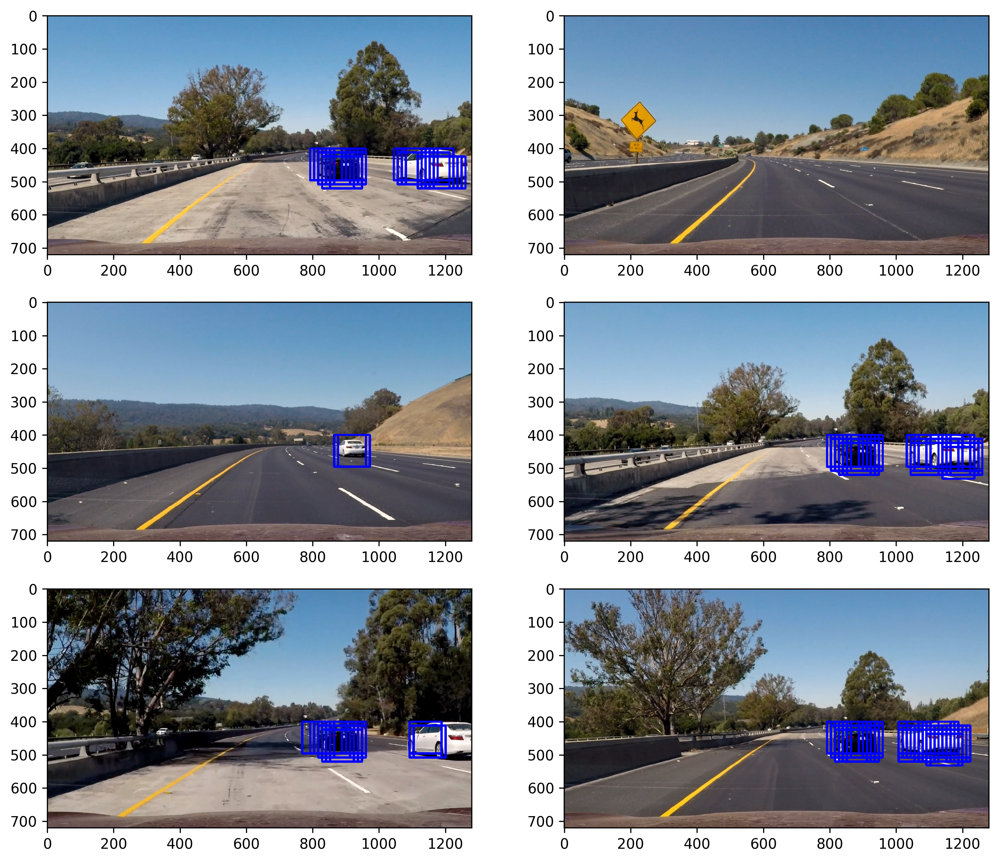

In [17]:
y_start_stop = [400, 656] # Min and max in y to search in slide_window()
y_range = {1.0 : (380,508), 
           1.5 : (380,572), 
           2.0 : (380,636), 
           2.5 : (380,700)}

# y_range = {1.0 : (380,508), 
#            1.1 : (380,572), 
#            1.2 : (380,636), 
#            1.3 : (380,700)}

images = glob.glob('test_images/*.jpg')
scale = 1.5
decision_th = 0.5
heatmaps_collection = collections.deque(maxlen=2)
multiple_detection = []
labeled_images = []
heatmap_array = []
output_images = [] # stored draw_img in this array

### single-scale pipeline ###
for img in images:
    image = mpimg.imread(img)
    out_img, heat = find_cars(image, y_start_stop[0], y_start_stop[1], scale, svc, X_scaler, orient, pix_per_cell, cell_per_block, spatial_size, hist_bins, decision_th)
#     heatmaps_collection.append(heat)  
#     heatmap_array.append(heat)
    # These are just for the debuging purposes
    multiple_detection.append(out_img)
    # Apply threshold to help remove false positives
#     heat_sum = sum(heatmaps_collection)
    heat_threshold = apply_threshold(heat,0.5)
    # Visualize the heatmap when displaying    
    heatmap = np.clip(heat_threshold, 0, 255)
    heatmap_array.append(heatmap)
    # Find final boxes from heatmap using label function
    labels = label(heatmap)
    labeled_images.append(labels)
    draw_img = draw_labeled_bboxes(np.copy(image), labels) #image
    output_images.append(draw_img)

### multi-scale pipeline ###
    
# for img in images:
#     image = mpimg.imread(img)
#     for scale in y_range.keys():
# #         y_start_stop = y_range[scale]
#         out_img, heat = find_cars(image, y_start_stop[0], y_start_stop[1], scale, svc, X_scaler, orient, pix_per_cell, cell_per_block, spatial_size, hist_bins)    
#         heatmaps_collection.append(heat)  
# #         heatmap_array.append(heat)
#         # These are just for the debuging purposes
#         multiple_detection.append(out_img)
#     # Apply threshold to help remove false positives
#     heat_sum = sum(heatmaps_collection)
#     heat_threshold = apply_threshold(heat_sum,2)
#     # Visualize the heatmap when displaying    
#     heatmap = np.clip(heat_threshold, 0, 255)
#     heatmap_array.append(heatmap)
#     # Find final boxes from heatmap using label function
#     labels = label(heatmap)
#     labeled_images.append(labels)
#     draw_img = draw_labeled_bboxes(np.copy(image), labels) #image
#     output_images.append(draw_img)

fig = plt.figure(figsize=(12,18), dpi=300)
for i, img in enumerate(multiple_detection):
    plt.subplot(5, 2, i+1)
    plt.imshow(img)
# print("size of the array of multiple_Boxes ", len(multiple_Boxes))

### Heatmaps
And also here we can see how do the heatmaps for each of those images look like:

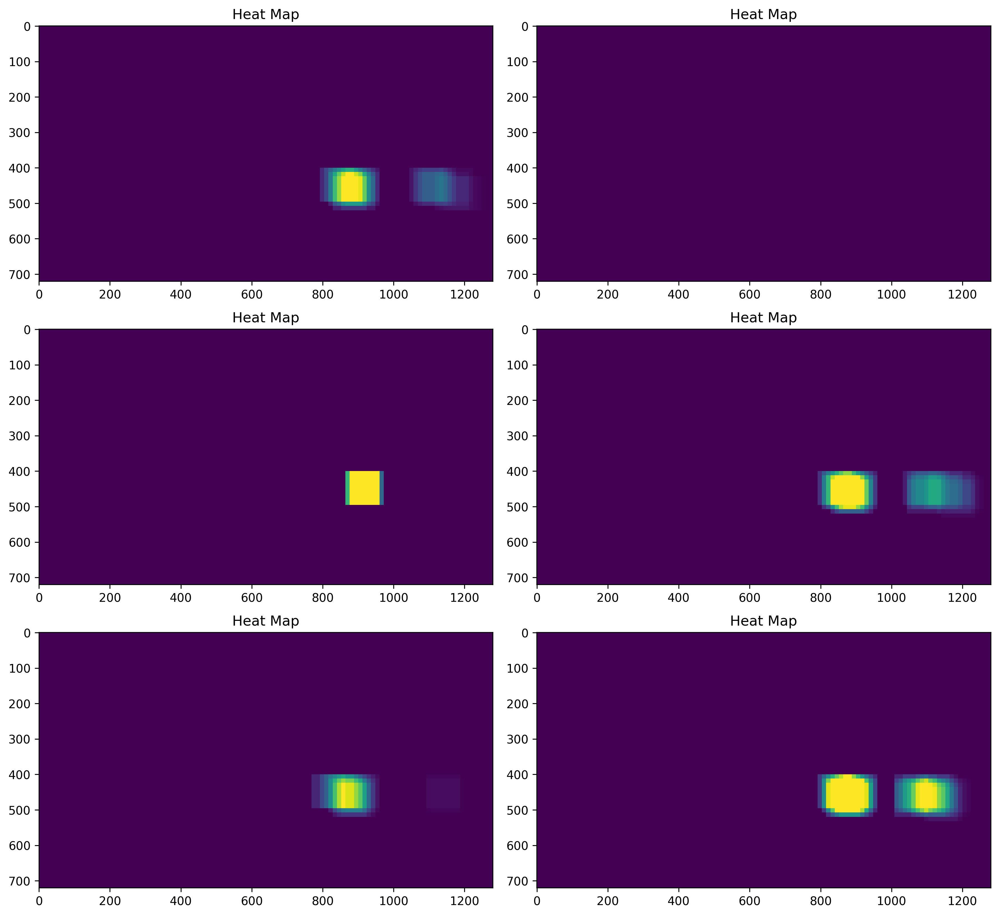

In [18]:
fig2 = plt.figure(figsize=(12,18), dpi=300)
for i, img in enumerate(heatmap_array):
#     print("The sum of heated pixels are:", np.count_nonzero(heatmap_array[i]))
    plt.subplot(5, 2, i+1)
    plt.imshow(img)
    plt.title('Heat Map')
    fig2.tight_layout()

In the heatmap, the brighter the pixel shows, the more often it has been detected. This is how we can make sure, a detected pixel is actually a part of a car, not a false positive and also we can detemine which of the detected boxes are overlaping with each other. So by putting a threshold on the heatmaps, we can reduce the number of false positives. 
There are different ways of filtering false positives using heatmaps. One approach that I tried was summing the heatmaps over multiple frames and then thresholding the result of them. I tried different deque sizes and different thresholds on this approach and albeit it helped to smooth out the jerky windows in the vidoe, still false postivies were happening. 

### Labels
Now let's see how do the labels look like:

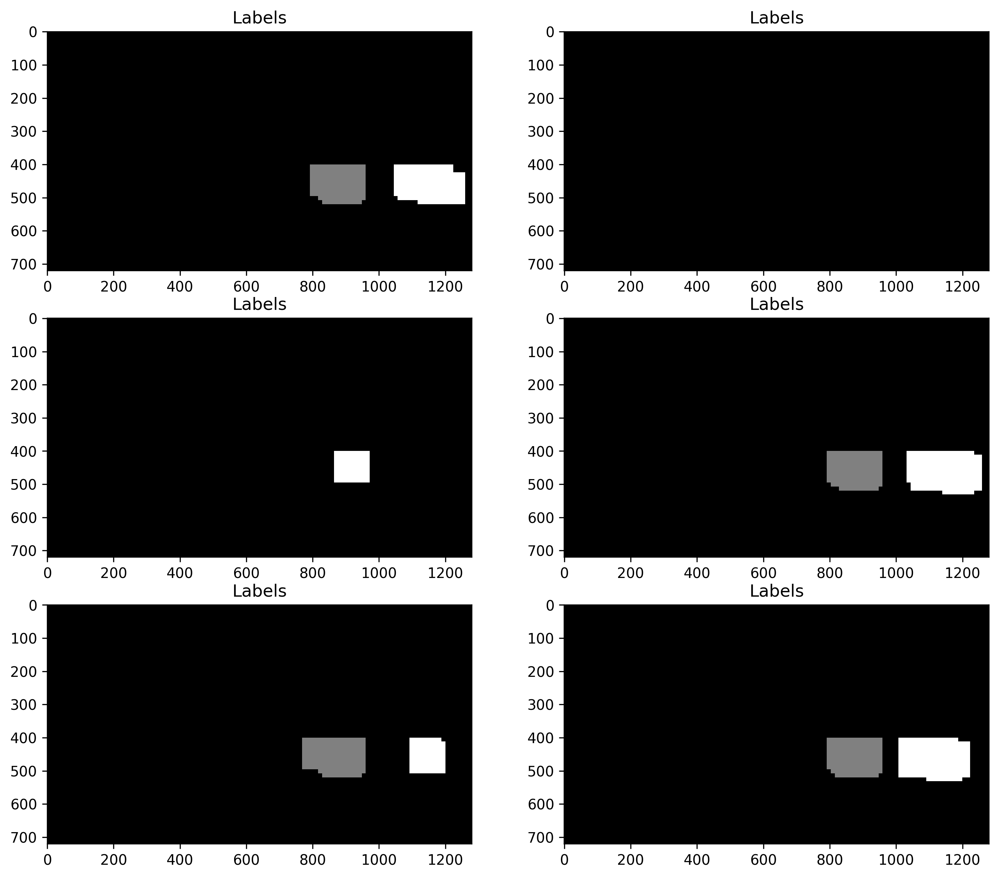

In [19]:
fig4 = plt.figure(figsize=(12,18), dpi=300)
for i, item in enumerate(labeled_images):
#     print("The sum of heated pixels are:", np.count_nonzero(heatmap_array[i]))
    plt.subplot(5, 2, i+1)
    plt.imshow(item[0], cmap='gray')
    plt.title('Labels')
    fig2.tight_layout()


### Final Result Images:
As you can see, there is no false positives, and also all the cars are perfectly detected.

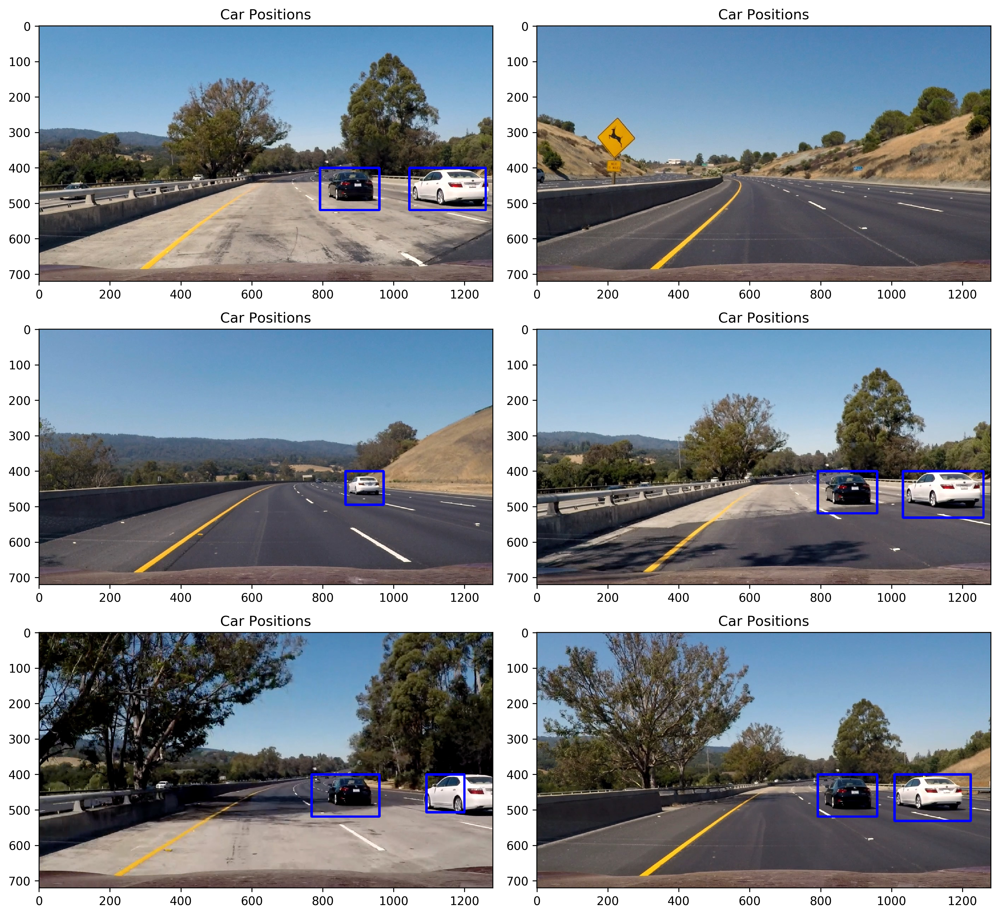

In [20]:
fig1 = plt.figure(figsize=(12,18), dpi=300)
for i, img in enumerate(output_images):
    plt.subplot(5, 2, i+1)
    plt.imshow(img)
    plt.title('Car Positions')
    fig1.tight_layout()


### Video Processing
Now I put everything together and define a pipeline to process the images of each frame of video. 
* To smooth out the bouncy bounding boxes, I learned that I can use deque to sum up heatmaps over multiple frames and threshold the result of summation. 
* I tried the multi-scaling approch on my video as well, however agian I was getting too many false postives, which were result of suming detections from multiple frames, so I decided not to use it. 

In [26]:
# import lesson_functions
heatmaps = collections.deque(maxlen=8) #8
# def image_pipeline(image):
#     heat = np.zeros_like(img[:,:,0]).astype(np.float)
#     for scale in y_range.keys():
# #         y_start_stop = y_range[scale]
#         out_img, heat = find_cars(image, y_start_stop[0], y_start_stop[1], scale, svc, X_scaler, orient, pix_per_cell, cell_per_block, spatial_size, hist_bins)    
# #         heatmaps_collection.append(heat)  
# #     heatmap_sum = sum(heatmaps_collection)
#     # Apply threshold to help remove false positive
#     heat = apply_threshold(heat,3) #7   
#     heatmap = np.clip(heat , 0, 255)
#     labels = label(heatmap)
#     draw_img = draw_labeled_bboxes(np.copy(image), labels)
#     return draw_img

def image_pipeline(image):
    out_img, heat = find_cars(image, y_start_stop[0], y_start_stop[1], scale, svc, X_scaler, orient, pix_per_cell, cell_per_block, spatial_size, hist_bins , decision_th)    
    heatmaps_collection.append(heat)  
    heatmap_sum = sum(heatmaps_collection)
    # Apply threshold to help remove false positive
    heat = apply_threshold(heatmap_sum,threshold) #4   
    heatmap = np.clip(heat , 0, 255)
    labels = label(heatmap)
    draw_img = draw_labeled_bboxes(np.copy(image), labels)
    return draw_img

In [27]:
# False-Positives in the beginning and shadow
# White car lost in the light part of the road
threshold = 5.5
decision_th = 0.5
video_in = 'Project4.mp4'
video_out = 'Line_Car_Combined.mp4'

clip = VideoFileClip(video_in)   # remember the output of this function is RGB
video_clip = clip.fl_image(image_pipeline)
video_clip.write_videofile(video_out, audio=False)

[MoviePy] >>>> Building video Line_Car_Combined.mp4
[MoviePy] Writing video Line_Car_Combined.mp4


100%|█████████▉| 1260/1261 [30:30<00:00,  1.05it/s]   


[MoviePy] Done.
[MoviePy] >>>> Video ready: Line_Car_Combined.mp4 



Here are the source of confusions:
* matplotlib will load png images with pixel values from 0 to 1.
* cv2 will read png images with pixel values between 0 to 255.
* cv2.cvtColot() on png images will output an images with pixels values 0 to 255.
* jpg images both matplotlib and cv2 will load images with pixel values between 0 and 255.
* VideoFileClip.fl_image will send jpg images to your pipeline function.
* cv2.imread results in BGR colored images vs matplotlib imread reads them RBG format.

In my case all the trainig images are in png format so they are scaled 0 tp 1 by matplotlibe imread. However all the test images as well as video frames are jpg and scaled 0 to 255 by matplotlib imread. So in find_cars method they all needed to be scaled down to 0 to 1 to be consistent with training data set. In both cases images after passing through cv2.cvtColor() function will be 0 to 255.

I also made sure to use just matplotlib imread to load images, just to avoid any inconsistency between color spaces. However to test different color spaces, I had to switch between cv2 and matplotlib imread funtions. 


Although I used the hard negetive mining approach to eliminate false poitives, I have mixed feelings about it. According to the link below provided by my reviewer, a hard negetive mining is basically " when you take that falsely detected patch, and explicitly create a negative example out of that patch, and add that negative to your training set. When you retrain your classifier, it should perform better with this extra knowledge, and not make as many false positives." I thought we should isolate our test set from our training set to prevent our classifier from cheating! My only guess is the fact that classifier is geting trained to detect cars, so probably that is alright.
"https://www.reddit.com/r/computervision/comments/2ggc5l/what_is_hard_negative_mining_and_how_is_it/"


### Link to my output Video

I have uploaded my output video on youtube as an unlisted video:
https://youtu.be/fDCZ7eCakhQ